In [16]:

import seaborn as sns
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt

In [17]:
df = pd.read_csv('../vehicles.csv')

In [18]:
#Reading Data
df.info()
df.isna().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51525 entries, 0 to 51524
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   price         51525 non-null  int64  
 1   model_year    47906 non-null  float64
 2   model         51525 non-null  object 
 3   condition     51525 non-null  object 
 4   cylinders     46265 non-null  float64
 5   fuel          51525 non-null  object 
 6   odometer      43633 non-null  float64
 7   transmission  51525 non-null  object 
 8   type          51525 non-null  object 
 9   paint_color   42258 non-null  object 
 10  is_4wd        25572 non-null  float64
 11  date_posted   51525 non-null  object 
 12  days_listed   51525 non-null  int64  
dtypes: float64(4), int64(2), object(7)
memory usage: 5.1+ MB


price               0
model_year       3619
model               0
condition           0
cylinders        5260
fuel                0
odometer         7892
transmission        0
type                0
paint_color      9267
is_4wd          25953
date_posted         0
days_listed         0
dtype: int64

In [19]:
#Fixing ModelYear Column
mean_year=int(df['model_year'].mean())
df['model_year']=df['model_year'].fillna(mean_year)
df['model_year']=df['model_year'].astype('Int64')

In [20]:
#Fixing Cylinders Column
df['cylinders'].mode()
df['cylinders']=df['cylinders'].fillna(df['cylinders'].mode()[0])
df['cylinders'].isna().sum()
df['cylinders'] = df['cylinders'].astype('Int64')

In [21]:
#Fixing Odometer Column (CHECK IF MEAN OR MEDIAN WORKS BETTER)
df['odometer']=df['odometer'].fillna(df['odometer'].mean())


In [22]:
#Fixing Paint Color Column
df['paint_color']=df['paint_color'].fillna(df['paint_color'].mode()[0])
df['paint_color'].isna().sum()

0

In [23]:
#Fixing Date Posted Column
df['date_posted']=pd.to_datetime(df['date_posted'], errors='coerce')

In [24]:
#Fixing 4WD Column
display(df['is_4wd'].value_counts())
df['is_4wd']=df['is_4wd'].fillna(False)
df['is_4wd']=df['is_4wd'].astype('bool')
display(df['is_4wd'].unique())

is_4wd
1.0    25572
Name: count, dtype: int64

array([ True, False])

In [25]:
#Basic Analysis
df.info()
df.isna().sum()
display(df.head(),df.tail(),df.isna().sum())
display(df.duplicated().sum()) 
df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51525 entries, 0 to 51524
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   price         51525 non-null  int64         
 1   model_year    51525 non-null  Int64         
 2   model         51525 non-null  object        
 3   condition     51525 non-null  object        
 4   cylinders     51525 non-null  Int64         
 5   fuel          51525 non-null  object        
 6   odometer      51525 non-null  float64       
 7   transmission  51525 non-null  object        
 8   type          51525 non-null  object        
 9   paint_color   51525 non-null  object        
 10  is_4wd        51525 non-null  bool          
 11  date_posted   51525 non-null  datetime64[ns]
 12  days_listed   51525 non-null  int64         
dtypes: Int64(2), bool(1), datetime64[ns](1), float64(1), int64(2), object(6)
memory usage: 4.9+ MB


,price,model_year,model,condition,cylinders,fuel,odometer,transmission,type,paint_color,is_4wd,date_posted,days_listed
0,9400,2011,bmw x5,good,6,gas,145000.000000,automatic,SUV,white,True,2018-06-23,19
1,25500,2009,ford f-150,good,6,gas,88705.000000,automatic,pickup,white,True,2018-10-19,50
2,5500,2013,hyundai sonata,like new,4,gas,110000.000000,automatic,sedan,red,False,2019-02-07,79
3,1500,2003,ford f-150,fair,8,gas,115553.461738,automatic,pickup,white,False,2019-03-22,9
4,14900,2017,chrysler 200,excellent,4,gas,80903.000000,automatic,sedan,black,False,2019-04-02,28


,price,model_year,model,condition,cylinders,fuel,odometer,transmission,type,paint_color,is_4wd,date_posted,days_listed
51520,9249,2013,nissan maxima,like new,6,gas,88136.000000,automatic,sedan,black,False,2018-10-03,37
51521,2700,2002,honda civic,salvage,4,gas,181500.000000,automatic,sedan,white,False,2018-11-14,22
51522,3950,2009,hyundai sonata,excellent,4,gas,128000.000000,automatic,sedan,blue,False,2018-11-15,32
51523,7455,2013,toyota corolla,good,4,gas,139573.000000,automatic,sedan,black,False,2018-07-02,71
51524,6300,2014,nissan altima,good,4,gas,115553.461738,automatic,sedan,white,False,2018-06-05,10


price           0
model_year      0
model           0
condition       0
cylinders       0
fuel            0
odometer        0
transmission    0
type            0
paint_color     0
is_4wd          0
date_posted     0
days_listed     0
dtype: int64

0

,price,model_year,cylinders,odometer,date_posted,days_listed
count,51525.000000,51525.0,51525.0,51525.000000,51525,51525.00000
mean,12132.464920,2009.697758,6.316623,115553.461738,2018-10-25 01:57:46.270742528,39.55476
min,1.000000,1908.0,3.0,0.000000,2018-05-01 00:00:00,0.00000
25%,5000.000000,2007.0,4.0,79181.000000,2018-07-29 00:00:00,19.00000
50%,9000.000000,2010.0,6.0,115553.461738,2018-10-25 00:00:00,33.00000
75%,16839.000000,2014.0,8.0,146541.000000,2019-01-21 00:00:00,53.00000
max,375000.000000,2019.0,12.0,990000.000000,2019-04-19 00:00:00,271.00000
std,10040.803015,6.06046,1.672586,59902.205520,NaN,28.20427


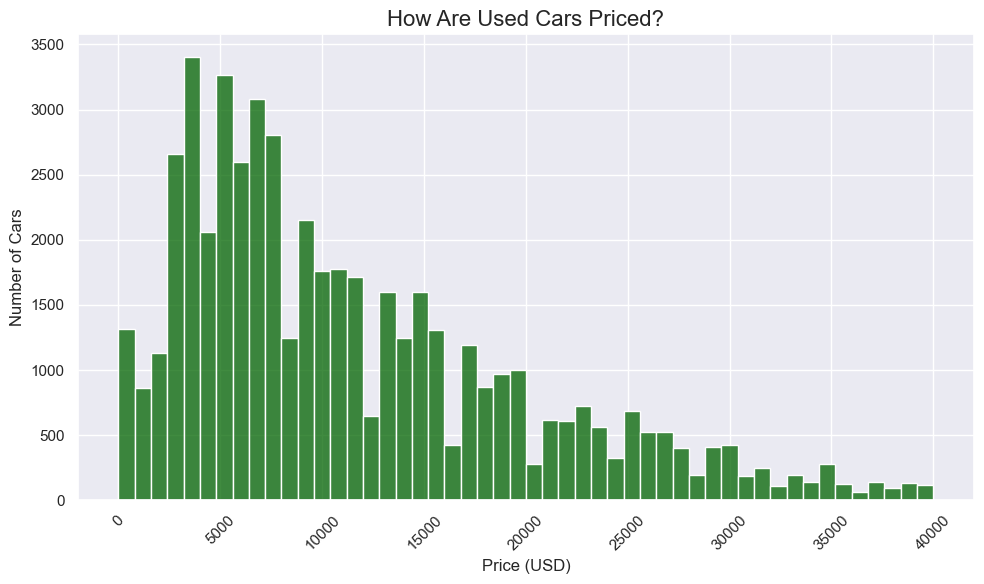

In [26]:
#Histogram ('How Are Used Cars Priced?')
df_filtered= df[df['price'] <40000] 
fig = px.histogram(
    df_filtered,
    x='price',
    title='How Are Used Cars Priced?',
    labels={'price': 'Price(USD)', 'count': 'Number of Cars'},
    nbins=50,
    color_discrete_sequence=['darkgreen']
)

fig.update_layout(
    xaxis_tickangle=45,
)
fig.show()

#Seaborn Histogram (duplicated the plots so that they can be displayed on GitHub)
df_filtered = df[df['price'] < 40000]
sns.set_theme()
plt.figure(figsize=(10, 6))
sns.histplot(df_filtered['price'], bins=50, kde=False, color='darkgreen')

plt.title('How Are Used Cars Priced?', fontsize=16)
plt.xlabel('Price (USD)', fontsize=12)
plt.ylabel('Number of Cars', fontsize=12)

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

This histogram represents the distribution of car prices with a realistic cutoff of 40,000, focusing on what an average buyer might expect. Since 75% of cars are priced below 16,839, excluding listings above 40,000 helps remove luxery or rare vechiles, which make up only about 4%-5% of the data. This cutoff still provides a braod but relevant view. The distribution is right-skewed, with most cars priced between 3,000 and 10,000, followed by a gradual decline in frequency as prices increase. 


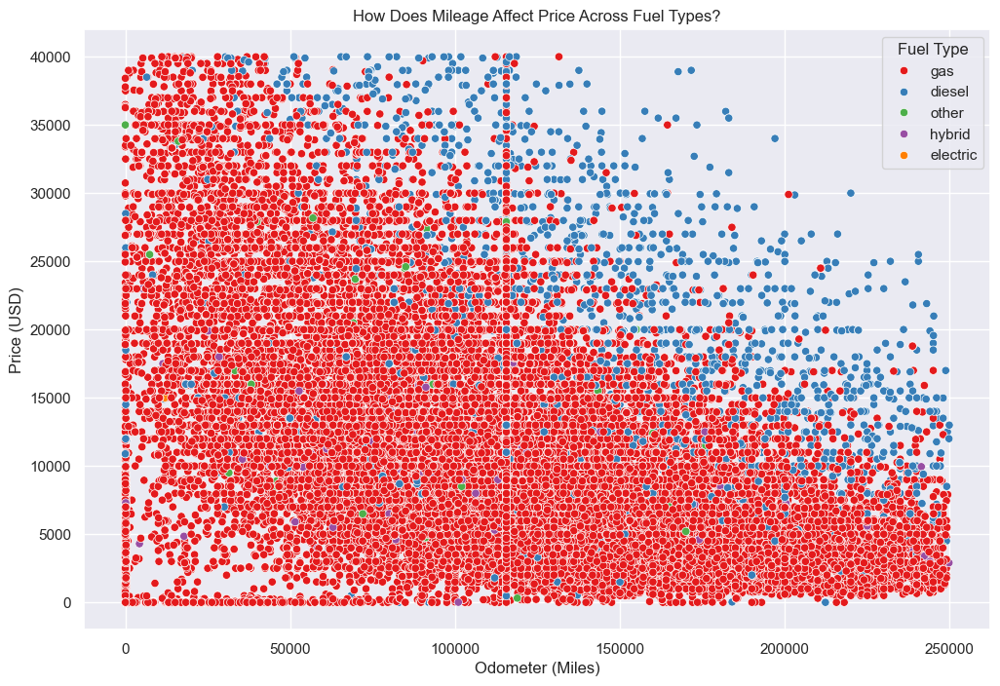

In [27]:
#Scatterplot ('How Does Mileage Affect Price Across Fuel Types?')
df_filtered2=df[
    (df['price'] <40000) & 
    (df['odometer'] <250000)]

fuel_vs_price=px.scatter(
    df_filtered2,
    x='odometer',
    y='price',
    title='How Does Mileage Affect Price Across Fuel Types?',
    labels={'odometer': 'Odometer (Miles)', 'price': 'Price (USD)', 'fuel': 'Fuel Type'},
    color='fuel',
    color_discrete_sequence=px.colors.qualitative.Set1,
    trendline='ols'
)
fuel_vs_price.for_each_trace(lambda t: t.update(line=dict(color='white')) if 'gas' in t.name else ())
fuel_vs_price.show()
df['fuel'].value_counts()

# Seaborn Scatterplot (duplicated the plots so that they can be displayed on GitHub)
df_filtered2 = df[(df['price'] < 40000) & (df['odometer'] < 250000)]

plt.figure(figsize=(12, 8))
sns.scatterplot(
    data=df_filtered2,
    x='odometer',
    y='price',
    hue='fuel',
    palette='Set1'
)

plt.title('How Does Mileage Affect Price Across Fuel Types?')
plt.xlabel('Odometer (Miles)')
plt.ylabel('Price (USD)')
plt.legend(title='Fuel Type')
plt.show()

This scatterplot shows that as mileage increases, used car prices generally decrease — a trend most evident in gas vehicles, which depreciate faster. Diesel vehicles retain value better, likely due to their durability. Hybrid, electric, and other fuel types are rare in the dataset, making their trends harder to interpret. Still, the market is likely to shift away from gas and diesel as alternative fuel vehicles become more common.

,price,model_year,cylinders,odometer,date_posted,days_listed,vehicle_age
count,49268.000000,49268.0,49268.0,49268.000000,49268,49268.000000,49268.0
mean,11691.448892,2010.009154,6.275047,112719.424833,2018-10-24 22:56:39.788909824,39.546501,8.990846
min,1.000000,1990.0,3.0,0.000000,2018-05-01 00:00:00,0.000000,0.0
25%,5000.000000,2007.0,4.0,80000.000000,2018-07-29 00:00:00,19.000000,5.0
50%,9000.000000,2010.0,6.0,115553.461738,2018-10-25 00:00:00,33.000000,9.0
75%,16490.000000,2014.0,8.0,144000.000000,2019-01-21 00:00:00,53.000000,12.0
max,39999.000000,2019.0,12.0,249870.000000,2019-04-19 00:00:00,271.000000,29.0
std,8486.868553,5.168214,1.675467,52218.483061,NaN,28.219793,5.168214


None

type
SUV            12028
sedan          11989
truck          11530
pickup          6527
coupe           2078
wagon           1497
mini-van        1140
hatchback       1014
van              618
convertible      381
other            243
offroad          199
bus               24
Name: count, dtype: int64

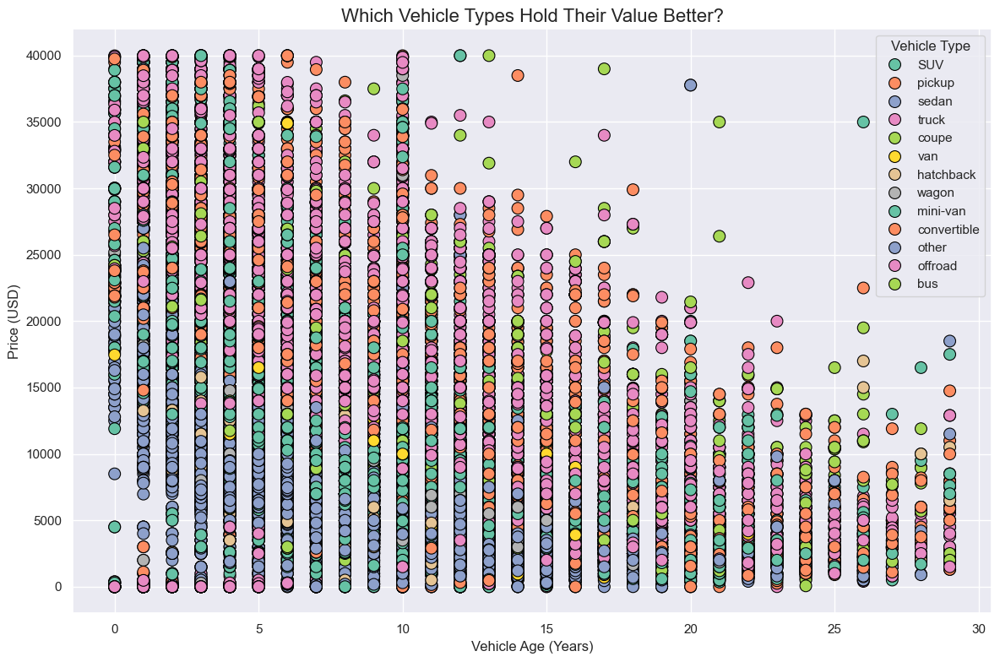

In [28]:
#Scatterplot ('Which Vechile Types Hold Their Value Better?')
df['vehicle_age']= 2019 - df['model_year']
df_filtered3= df[
    (df['price'] < 40000) &
    (df['vehicle_age'] < 30) &
    (df['odometer'] < 250000)
]

fig=px.scatter(
    df_filtered3,
    x='vehicle_age',
    y='price',
    color='type',
    title='Which Vehicle Types Hold Their Value Better?',
    labels={
        'vehicle_age': 'Vehicle Age (Years)',
        'price': 'Price (USD)',
        'type': 'Vehicle Type'
    },
    color_discrete_sequence=px.colors.qualitative.Set2,
    trendline='ols'
)

fig.show()
describe_=display(df_filtered3.describe())
vehicle_type_summary = df_filtered3['type'].value_counts()
display(describe_,vehicle_type_summary)

# Seaborn Scatterplot (duplicated the plots so that they can be displayed on GitHub)
df['vehicle_age'] = 2019 - df['model_year']
df_filtered3 = df[
    (df['price'] < 40000) &
    (df['vehicle_age'] < 30) &
    (df['odometer'] < 250000)
]

plt.figure(figsize=(12, 8))
sns.scatterplot(
    data=df_filtered3,
    x='vehicle_age',
    y='price',
    hue='type',
    palette='Set2',
    s=100,  
    edgecolor='black'
)

plt.title('Which Vehicle Types Hold Their Value Better?', fontsize=16)
plt.xlabel('Vehicle Age (Years)', fontsize=12)
plt.ylabel('Price (USD)', fontsize=12)
plt.legend(title='Vehicle Type')

plt.tight_layout()
plt.show()



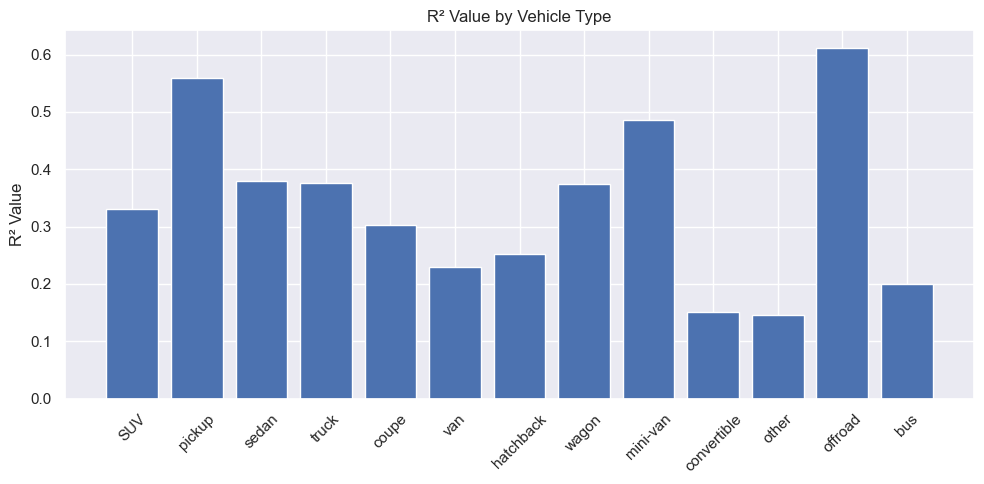

In [29]:
r2_values={
    'SUV': 0.3306,
    'pickup': 0.5595,
    'sedan': 0.3791,
    'truck': 0.3754,
    'coupe': 0.3026,
    'van': 0.2287,
    'hatchback': 0.2520,
    'wagon': 0.3751,
    'mini-van': 0.4852,
    'convertible': 0.1511,
    'other': 0.1459,
    'offroad': 0.6116,
    'bus': 0.1994
}

fig, ax = plt.subplots(figsize=(10, 5))
vehicle_types = list(r2_values.keys())
r2_vals = list(r2_values.values())

ax.bar(vehicle_types, r2_vals)
ax.set_xticks(range(len(vehicle_types)))
ax.set_xticklabels(vehicle_types, rotation=45)
ax.set_ylabel('R² Value')
ax.set_title('R² Value by Vehicle Type')

plt.tight_layout()
plt.show()

This scatterplot shows the varying depreciation rates across different vehicle types. The R² values indicate that offroad (0.6116) and pickup (0.5595) vehicles have the strongest relationship between age and price, meaning their value depreciation is more predictable over time. In contrast, convertibles (0.1511) and other vehicles (0.1459) have the weakest relationship, suggesting greater price variability not explained by age. SUVs, sedans, and trucks—common vehicle types—fall in the mid-range, with R² values around 0.33 to 0.38, indicating moderate value retention patterns. Overall, vehicle type plays a significant role in how predictability a vehicle depreciates in value over time. 

/var/folders/mq/lgxmrm713137k51prklrhndw0000gn/T/ipykernel_19071/1486935996.py:38: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/var/folders/mq/lgxmrm713137k51prklrhndw0000gn/T/ipykernel_19071/1486935996.py:38: UserWarning:


The palette list has fewer values (1) than needed (13) and will cycle, which may produce an uninterpretable plot.



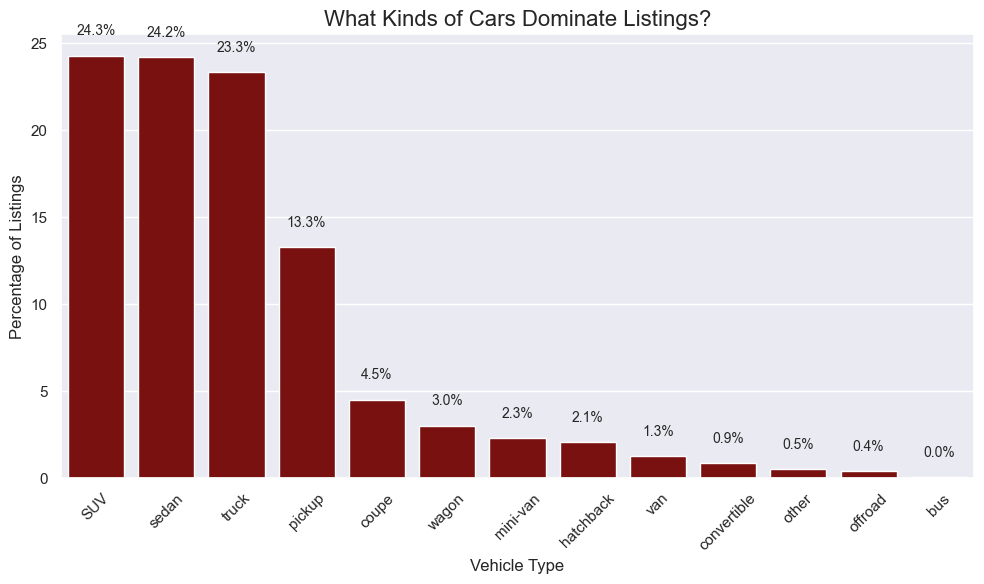

In [15]:
#Histogram ('What Kinds of Cars Dominate Listings')
df_filtered4= df[
    (df['price'] < 40000) &
    (df['odometer'] < 250000)
    ]
type_counts = df_filtered4['type'].value_counts(normalize=True).reset_index()
type_counts.columns = ['type', 'percent']
type_counts['percent'] *= 100

fig=px.bar(
    type_counts,
    x='type',
    y='percent',
    title='What Kinds of Cars Dominate Listings?',
    labels= {'type': 'Vehicle Type', 'percent': 'Percentage of Listings'},
    color_discrete_sequence=['darkred']
)
fig.update_layout(
    xaxis_tickangle=45,
    yaxis_title='Percentage of Listings'
)
fig.update_traces(
    texttemplate='%{y:.1f}%',
    textposition='outside'
)
fig.show()

# Seaborn Graph (created using Seaborn and Matplotlib for better visualization)

df_filtered4 = df[
    (df['price'] < 40000) &
    (df['odometer'] < 250000)
]
type_counts = df_filtered4['type'].value_counts(normalize=True).reset_index()
type_counts.columns = ['type', 'percent']
type_counts['percent'] *= 100
plt.figure(figsize=(10, 6))
sns.barplot(
    data=type_counts,
    x='type',
    y='percent',
    palette=['darkred']
)

plt.title('What Kinds of Cars Dominate Listings?', fontsize=16)
plt.xlabel('Vehicle Type', fontsize=12)
plt.ylabel('Percentage of Listings', fontsize=12)

for index, value in enumerate(type_counts['percent']):
    plt.text(index, value + 1, f'{value:.1f}%', ha='center', va='bottom', fontsize=10)
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


The histogram shows the distribution of vehicle types in the listings. SUVs, Sedans, and Trucks dominate the listings at around 24%. Pickups make up about 13%, and Coupes are at 4.5%. Wagons and Mini-vans together account for ≈5%, while the remaining ≈5% includes Bus, Off-road, Other, Convertibles, Vans, and Hatchbacks, which together make up 4.3% of all listings with the filters (price < 40000, odometer < 250000).

In conclusion, the used car market is shaped by a mix of popular, practical vehicles like SUVs and Trucks, which dominate the listings. There's also a noticeable trend toward better value retention in certain vehicle types, particularly Off-road vehicles and Pickups. As the market evolves, we can expect a growing trend toward fuel-efficient and eco-friendly vehicles, although these types still represent a relatively small fraction of the total listings.